## Notebook to experiment with different Albumentations Augmentations

First load our image

Image shape: (956, 1300, 3)


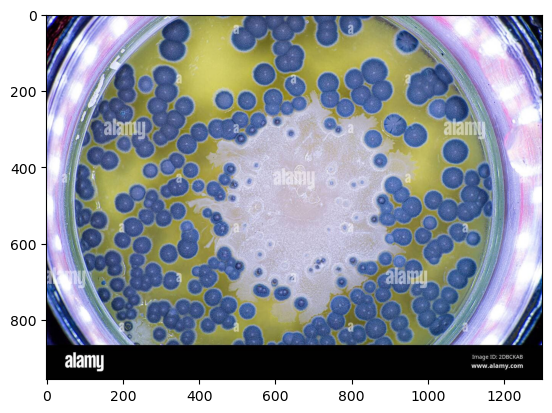

In [4]:
from skimage.io import imread
import matplotlib.pyplot as plt
import numpy as np

img = imread(r'D:\images\tnia-python-images\imagesc\2025_04_30_scale\image (3).jpg')

print('Image shape:', img.shape)

plt.imshow(img)

Now define some utilities for showing image side by side and for normalizing the images. 

In [7]:

def imshow2(img1, img2, title1='Image 1', title2='Image 2', cmap=None):
    """
    Display two images side by side using matplotlib.

    Parameters:
    - img1, img2: The image arrays (e.g., NumPy arrays).
    - title1, title2: Titles for the subplots.
    - cmap: Optional colormap (e.g., 'gray').
    """
    fig, axes = plt.subplots(1, 2, figsize=(10, 5))
    axes[0].imshow(img1, cmap=cmap)
    axes[0].set_title(title1)
    axes[0].axis('off')
    axes[1].imshow(img2, cmap=cmap)
    axes[1].set_title(title2)
    axes[1].axis('off')
    plt.tight_layout()
    plt.show()

Image min/max: 0 255
Normalized image min/max: 0.0 1.0


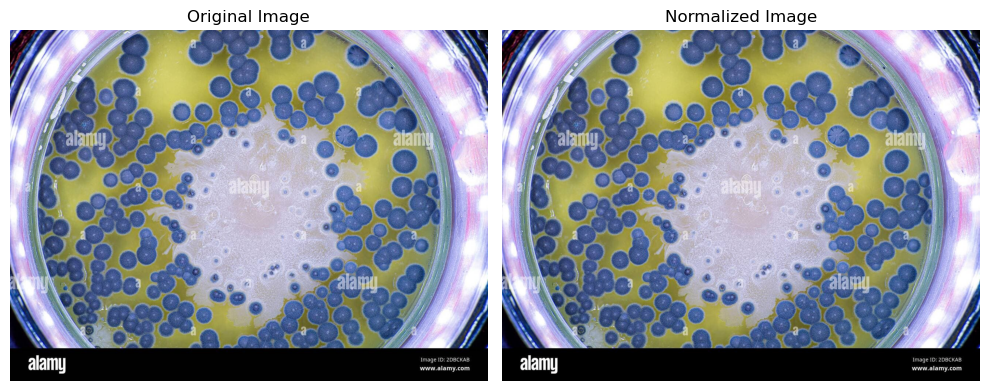

In [9]:
quantile_low = 0.01
quantile_high = 0.99
eps = 1.e-20
clip = True

def normalize_(img, low, high, eps=1.e-20, clip=True):
    # we have to add a small eps to handle the case where both quantiles are equal
    # to avoid dividing by zero
    scaled = (img - low) / (high - low + eps)

    if clip:
        scaled = np.clip(scaled, 0, 1)

    return scaled

# if the image is 2D set channels to False
if len(img.shape) == 2:
    channels = False
else:
    channels = True

if channels == False:
    qlow = np.quantile(img, quantile_low)
    qhigh = np.quantile(img, quantile_high)

    img_normalized = normalize_(img, low=qlow, high=qhigh, eps=eps, clip=clip)
else:
    num_channels = img.shape[-1]
    img_normalized = np.zeros(img.shape, dtype=np.float32)
    for i in range(num_channels):
        qlow = np.quantile(img[...,i], quantile_low)
        qhigh = np.quantile(img[...,i], quantile_high)
        img_normalized[...,i] = normalize_(img[...,i], low=qlow, high=qhigh, eps=eps, clip=clip)

print('Image min/max:', img.min(), img.max())
print('Normalized image min/max:', img_normalized.min(), img_normalized.max())

imshow2(img, img_normalized, 'Original Image', 'Normalized Image', cmap='gray')


## RandomSizedCrop (crop and resize)

RandomSizedCrop is used to create a crop of pixel size ```patch_size``` based on a min/max height. 

It does both a crop and resize.  

a) Crop an area using a size in the range ```min_max_height```
b) resize that area to ```patch_size```

original image shape: (956, 1300, 3)
transformed image shape: (256, 256, 3)


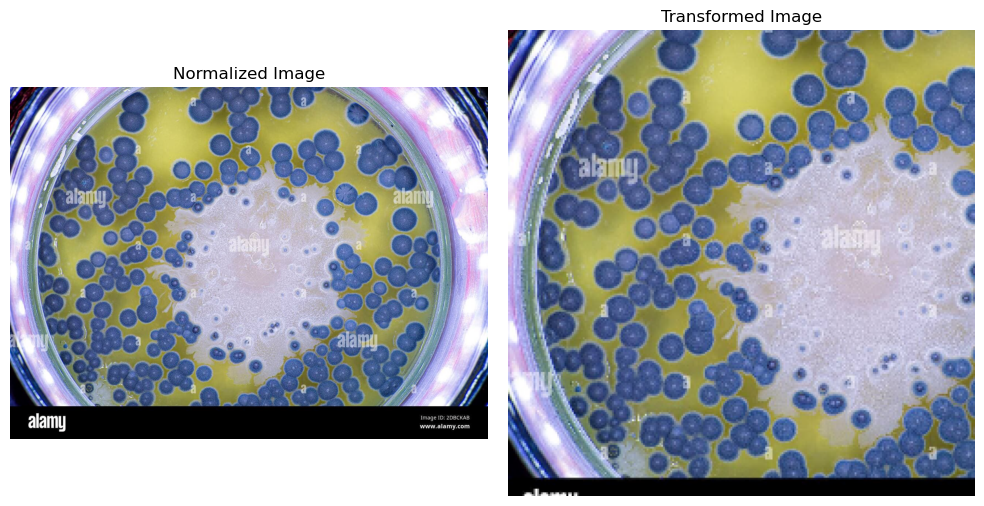

original image shape: (956, 1300, 3)
transformed image shape: (256, 256, 3)


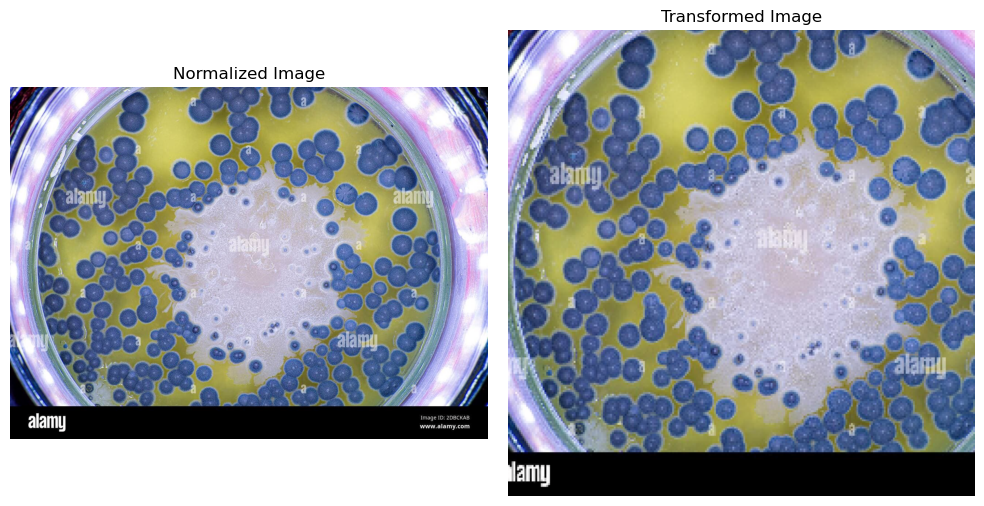

original image shape: (956, 1300, 3)
transformed image shape: (256, 256, 3)


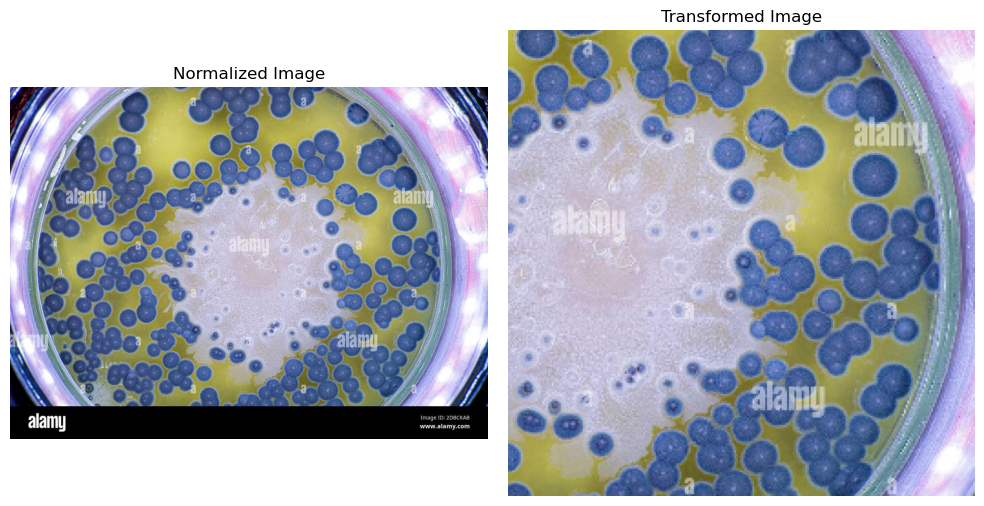

original image shape: (956, 1300, 3)
transformed image shape: (256, 256, 3)


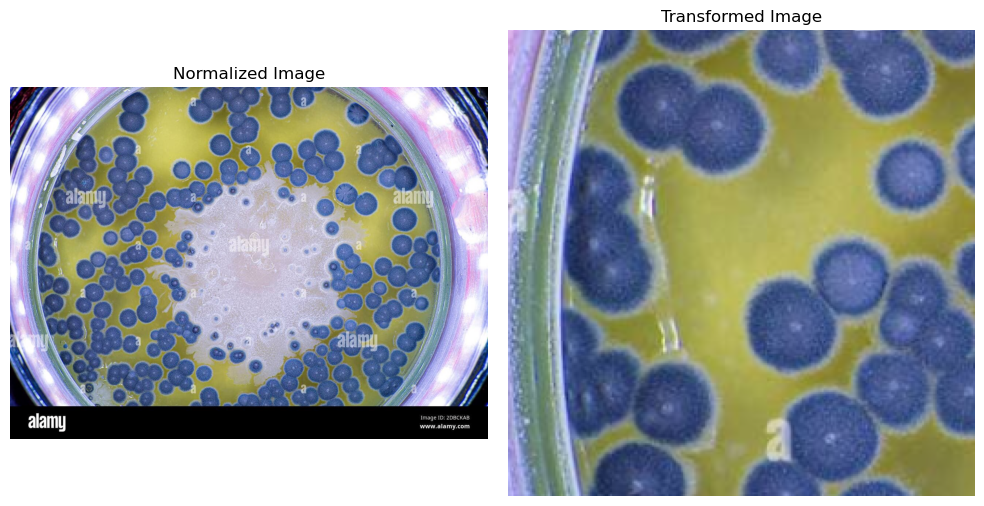

original image shape: (956, 1300, 3)
transformed image shape: (256, 256, 3)


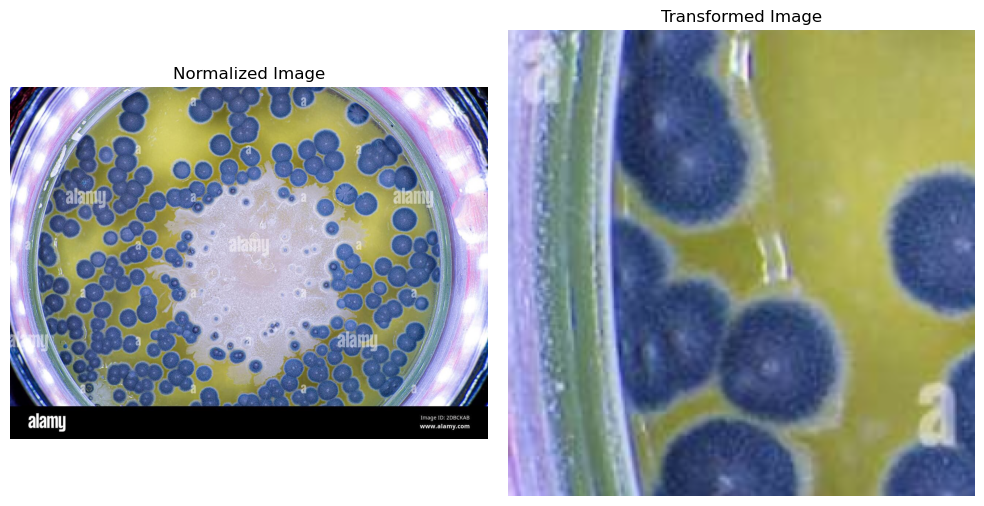

In [16]:
import albumentations as A

patch_size = 256
min_max_height = (64, 1024)  # Randomly crop between 50% and 100% of the height

transform = A.RandomSizedCrop(min_max_height=min_max_height, size=(patch_size, patch_size), p=1.0)

for i in range(5):
    transformed = transform(image=img_normalized)
    print('original image shape:', img_normalized.shape)
    print('transformed image shape:', transformed['image'].shape)
    imshow2(img_normalized, transformed['image'], 'Normalized Image', 'Transformed Image', cmap='gray')

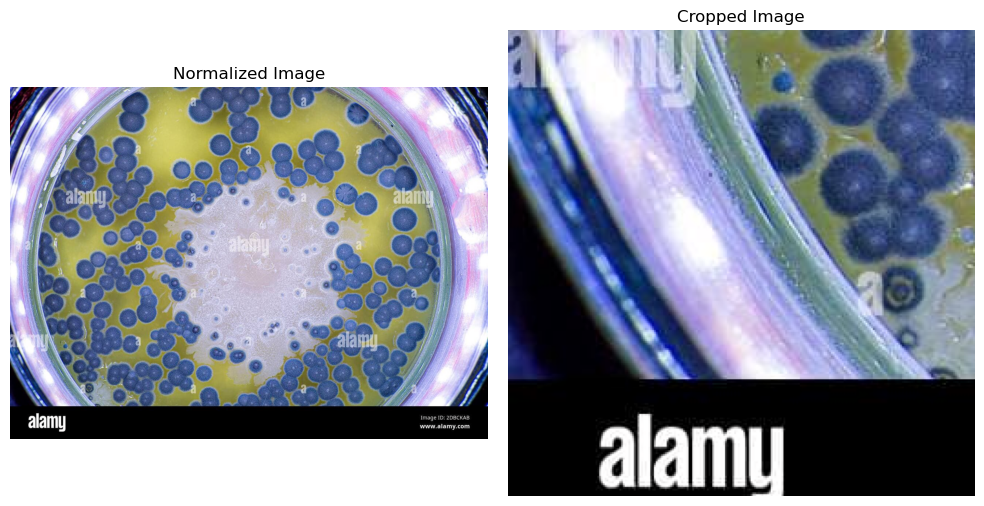

In [21]:
starty = 675
startx = 0
crop = img_normalized[starty:starty+patch_size, startx:startx+patch_size]

imshow2(img_normalized, crop, 'Normalized Image', 'Cropped Image', cmap='gray')

## Flips and 90 degree rotation

Here we do flips and rotations and also show how to build a transform from multiple augmentations (in real applications we often just build a single transform from every augmentation we use)

original image shape: (256, 256, 3)
transformed image shape: (256, 256, 3)


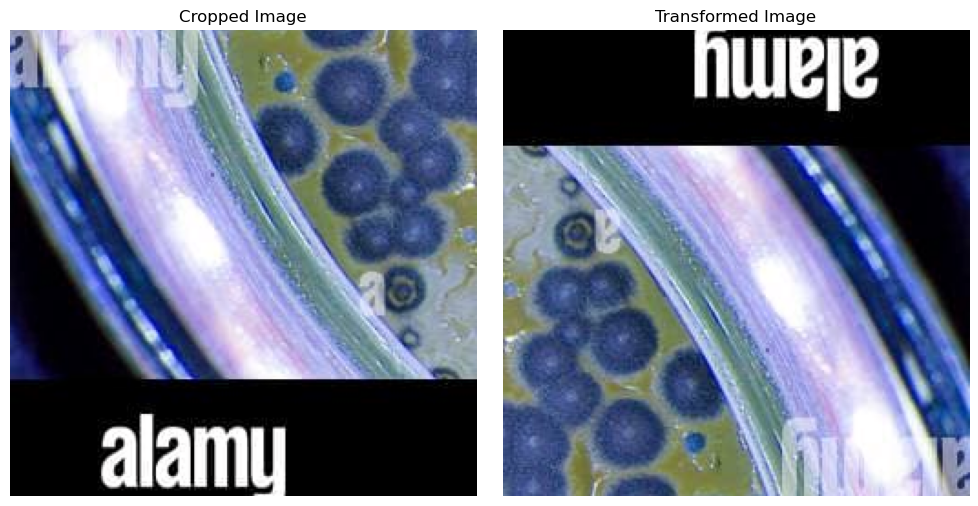

original image shape: (256, 256, 3)
transformed image shape: (256, 256, 3)


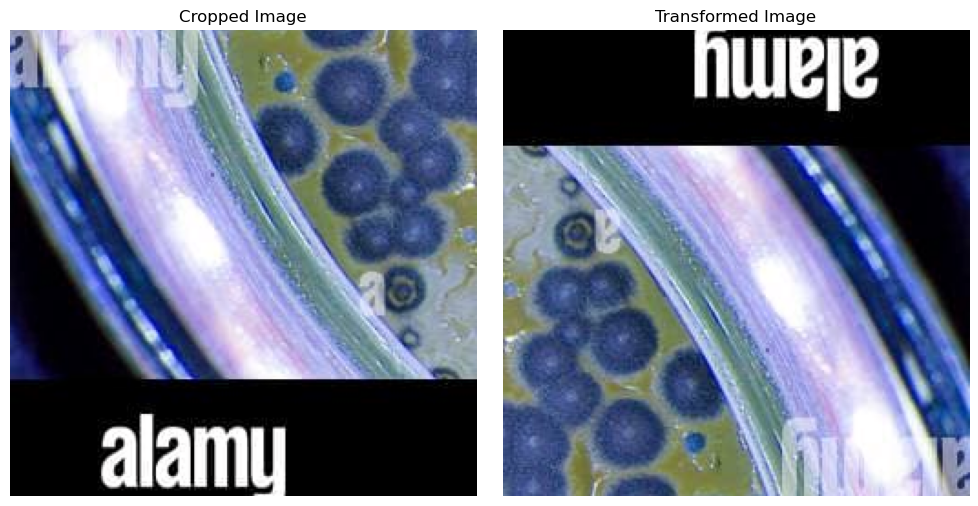

original image shape: (256, 256, 3)
transformed image shape: (256, 256, 3)


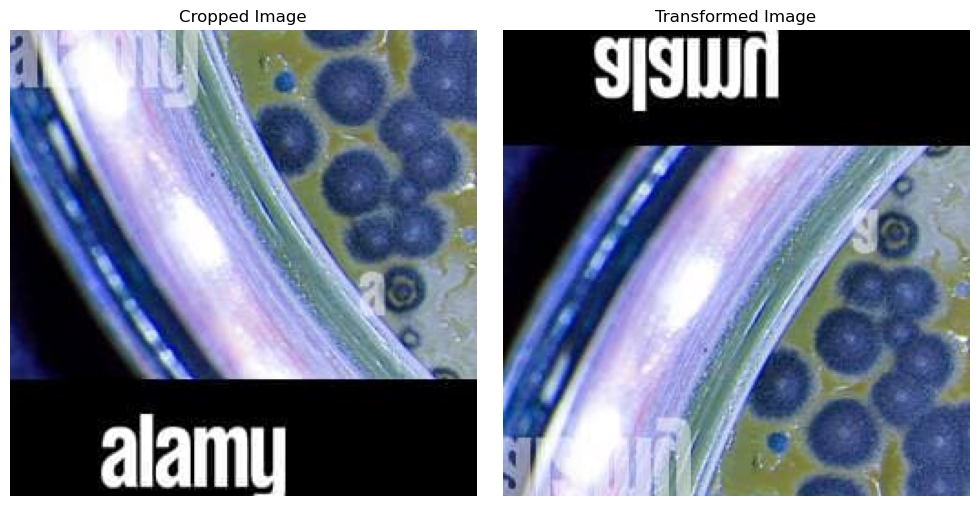

original image shape: (256, 256, 3)
transformed image shape: (256, 256, 3)


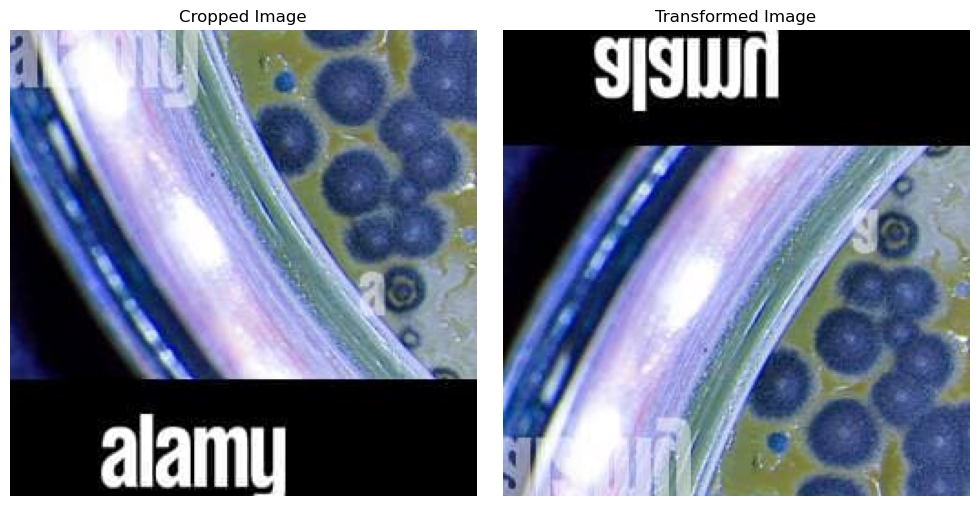

original image shape: (256, 256, 3)
transformed image shape: (256, 256, 3)


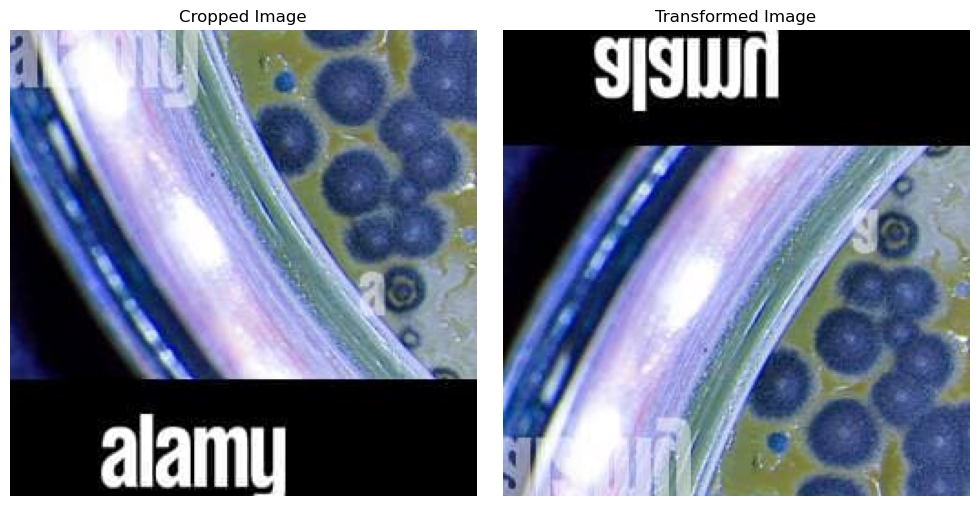

In [37]:
augmentations = []
augmentations.append(A.VerticalFlip(p=0.5))
augmentations.append(A.HorizontalFlip(p=0.5))
augmentations.append(A.RandomRotate90(p=0.5))

transform = A.Compose(augmentations)
for i in range(5):
    transformed = transform(image=crop)
    print('original image shape:', crop.shape)
    print('transformed image shape:', transformed['image'].shape)
    imshow2(crop, transformed['image'], 'Cropped Image', 'Transformed Image', cmap='gray')



## Random Brightness

original image shape: (256, 256, 3)
transformed image shape: (256, 256, 3)


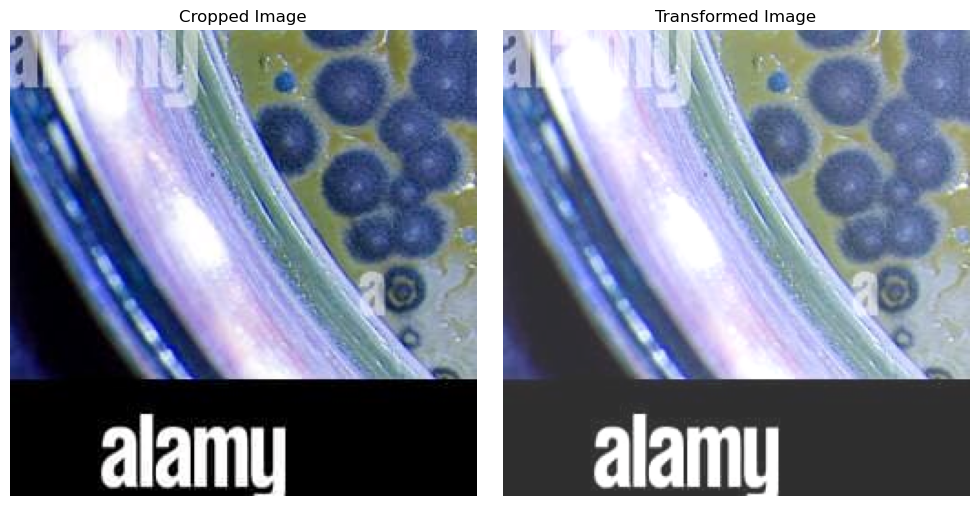

original image shape: (256, 256, 3)
transformed image shape: (256, 256, 3)


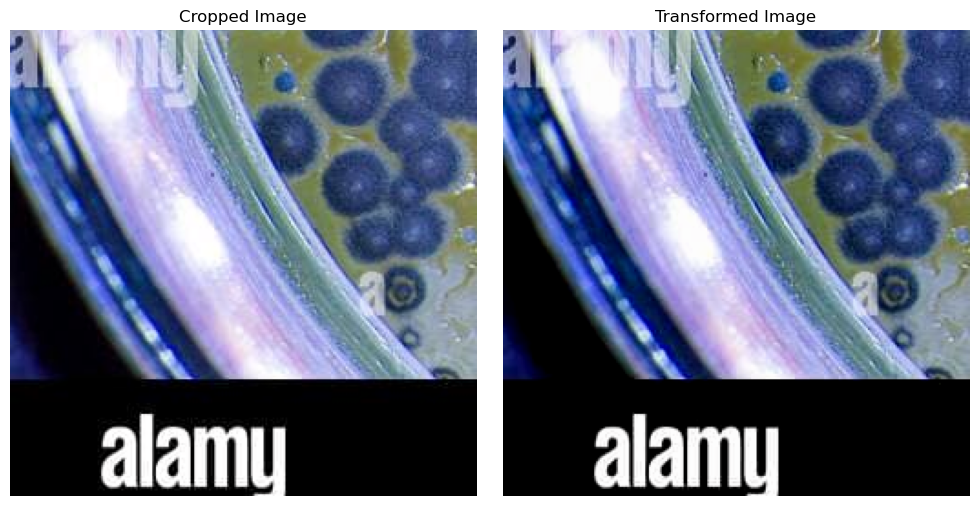

original image shape: (256, 256, 3)
transformed image shape: (256, 256, 3)


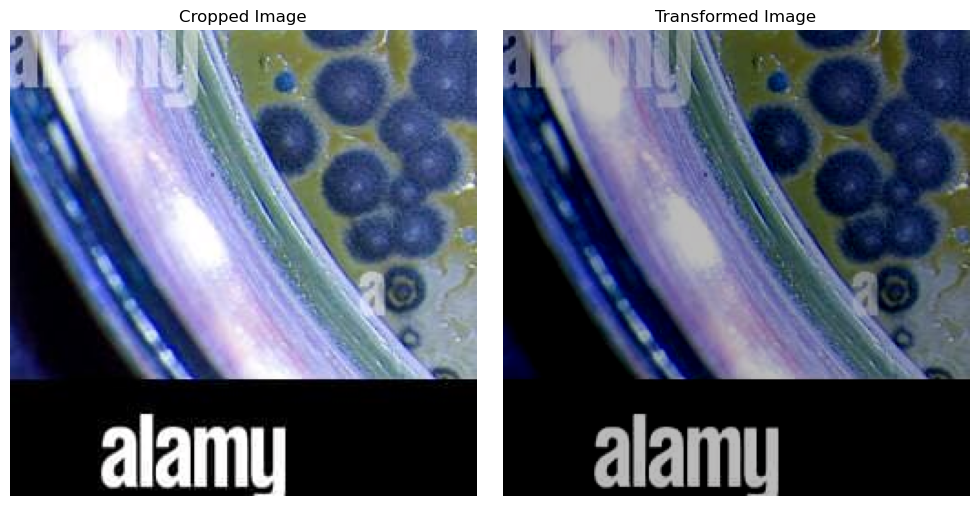

original image shape: (256, 256, 3)
transformed image shape: (256, 256, 3)


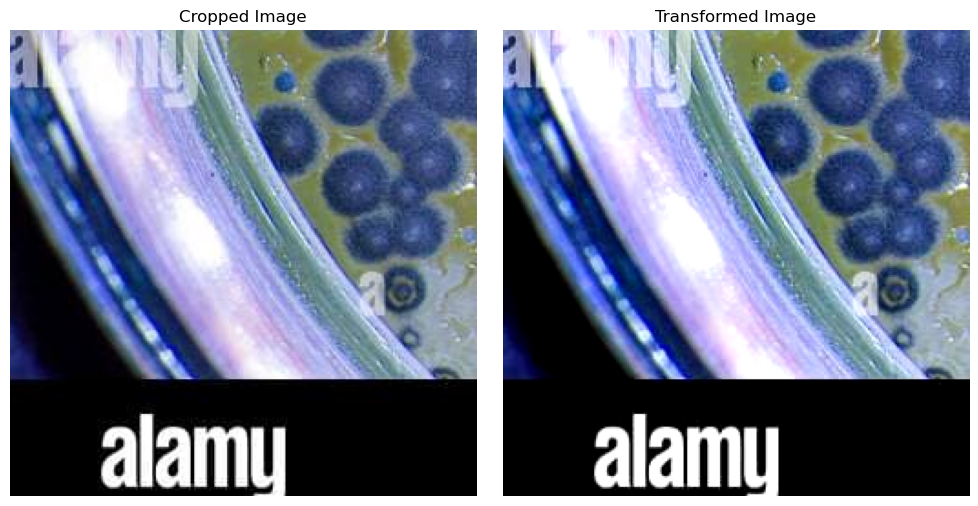

original image shape: (256, 256, 3)
transformed image shape: (256, 256, 3)


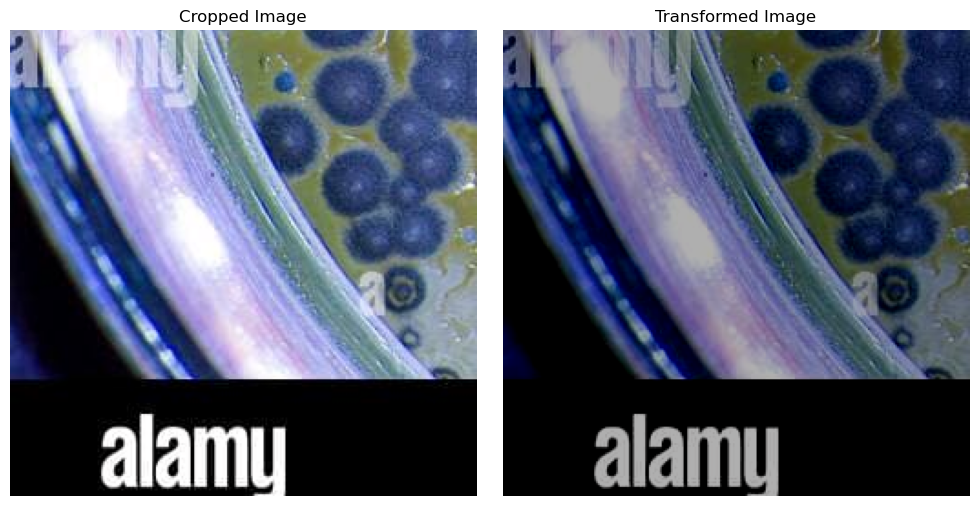

In [24]:
transform = A.RandomBrightnessContrast(p=1.0)

brightness_limit = (-0.8, 0.8)
contrast_limit = (-0.8, 0.8)

for i in range(5):
    transformed = transform(image=crop, brightness_limit=brightness_limit, contrast_limit=contrast_limit)
    print('original image shape:', crop.shape)
    print('transformed image shape:', transformed['image'].shape)
    imshow2(crop, transformed['image'], 'Cropped Image', 'Transformed Image', cmap='gray')


original image shape: (256, 256, 3)
transformed image shape: (256, 256, 3)


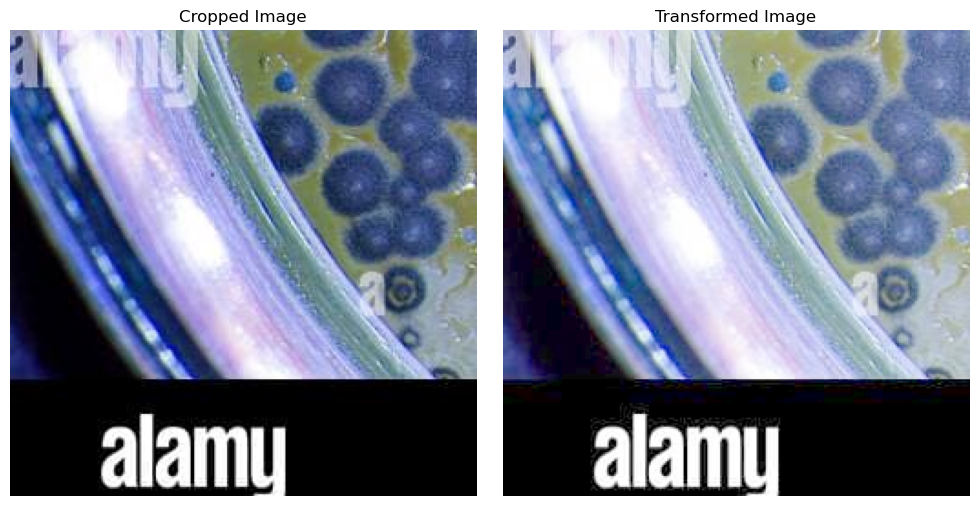

original image shape: (256, 256, 3)
transformed image shape: (256, 256, 3)


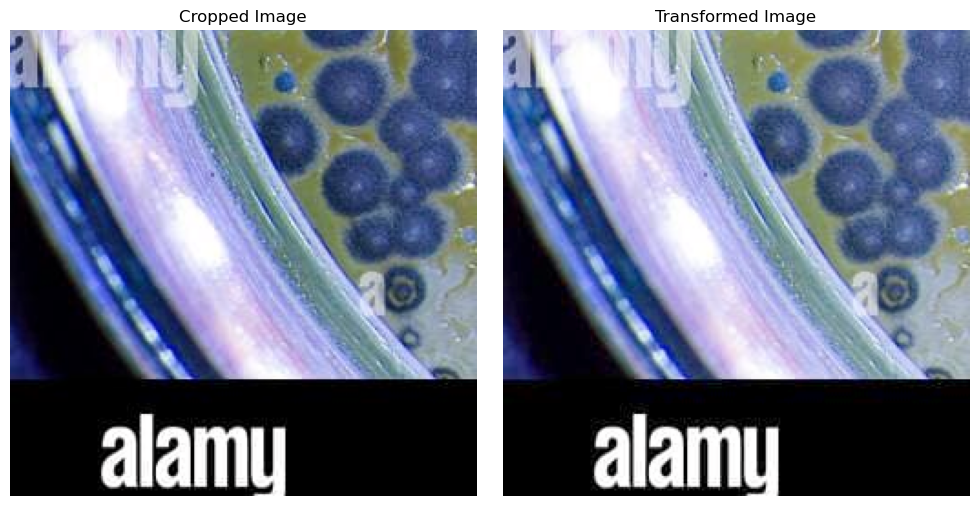

original image shape: (256, 256, 3)
transformed image shape: (256, 256, 3)


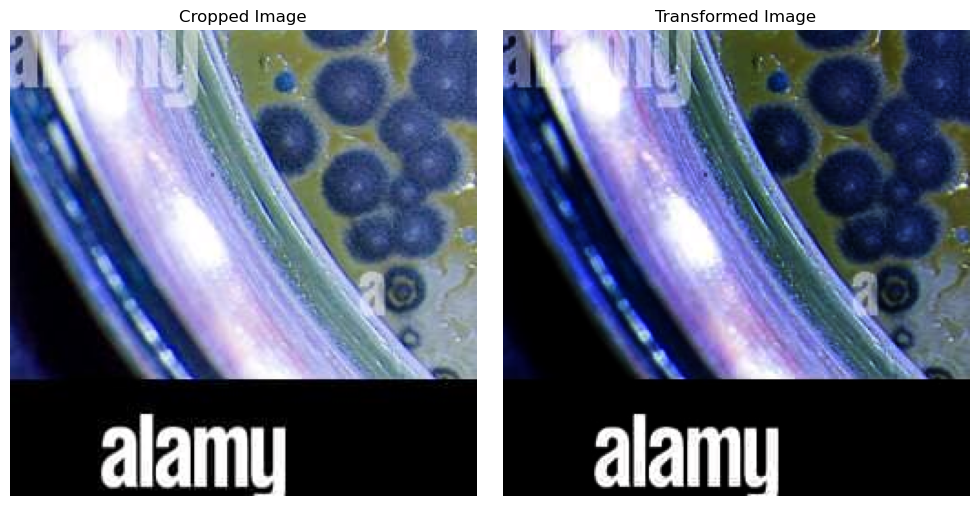

original image shape: (256, 256, 3)
transformed image shape: (256, 256, 3)


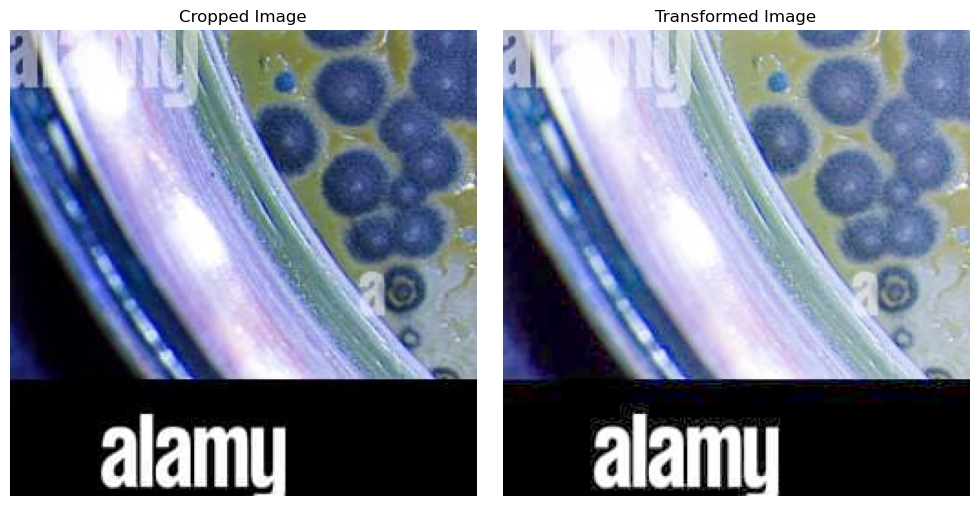

original image shape: (256, 256, 3)
transformed image shape: (256, 256, 3)


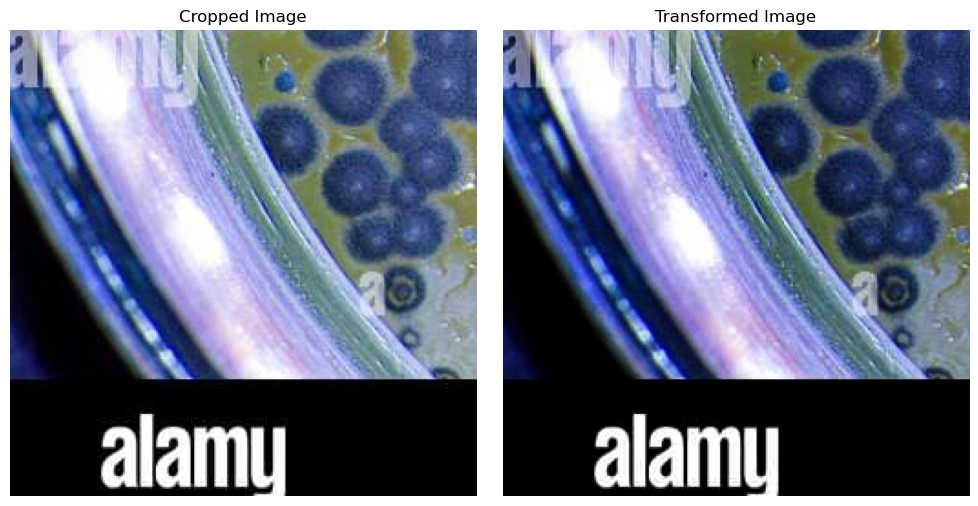

In [27]:

gamma_limit = (20, 180) #gamma_limit = (80, 120)

transform = A.RandomGamma(gamma_limit=gamma_limit, p=1.0)


for i in range(5):
    transformed = transform(image=crop)
    print('original image shape:', crop.shape)
    print('transformed image shape:', transformed['image'].shape)
    imshow2(crop, transformed['image'], 'Cropped Image', 'Transformed Image', cmap='gray')

## Color augmentation

original image shape: (256, 256, 3)
transformed image shape: (256, 256, 3)


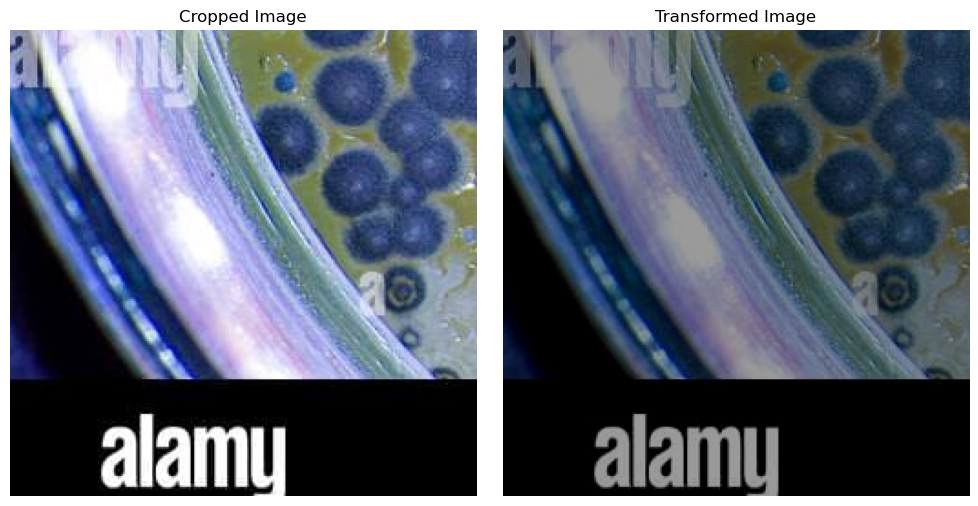

original image shape: (256, 256, 3)
transformed image shape: (256, 256, 3)


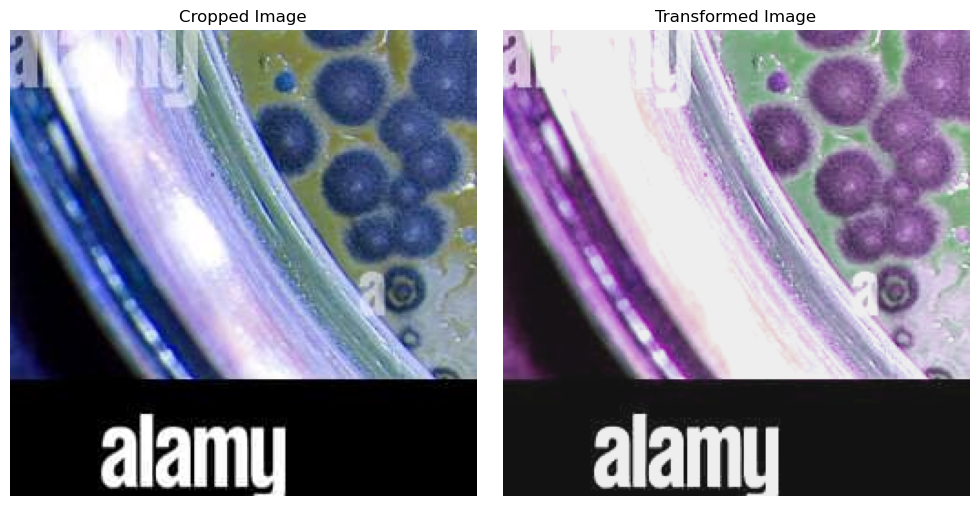

original image shape: (256, 256, 3)
transformed image shape: (256, 256, 3)


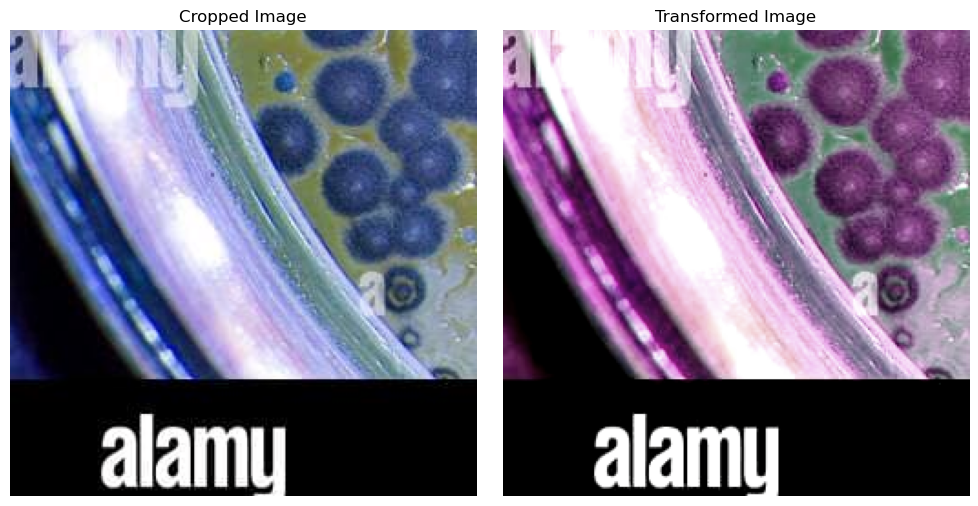

original image shape: (256, 256, 3)
transformed image shape: (256, 256, 3)


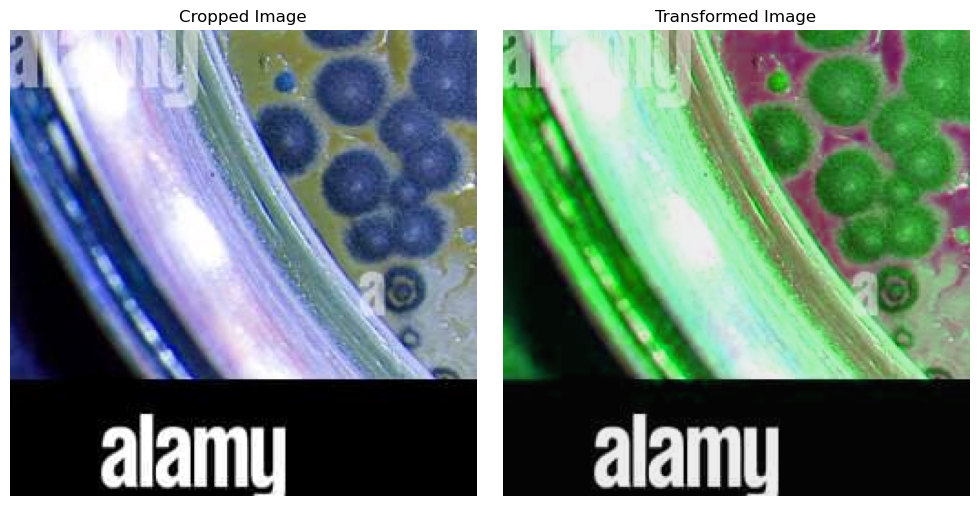

original image shape: (256, 256, 3)
transformed image shape: (256, 256, 3)


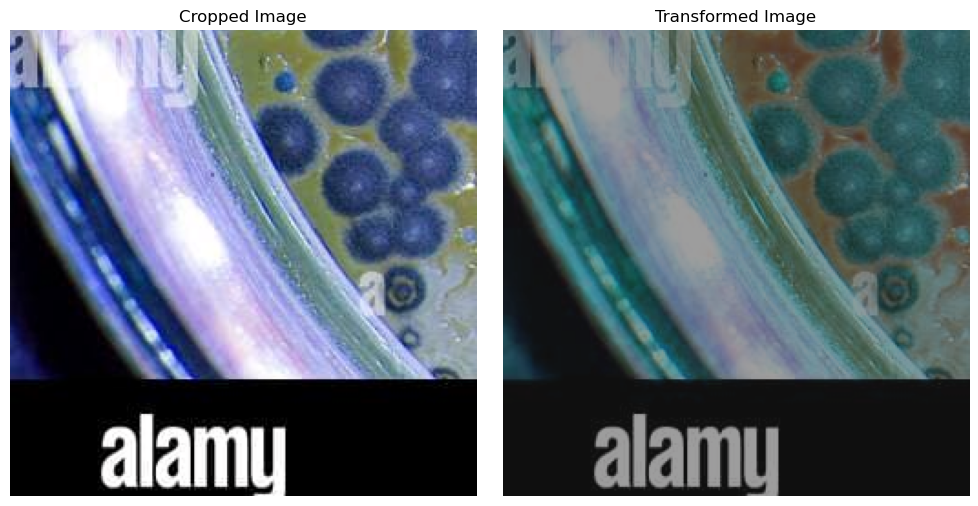

In [28]:
hue = 0.5
brightness = 0.5
saturation = 0.5

transform = A.ColorJitter(hue=hue, brightness=brightness, saturation=saturation, p=1.0)

for i in range(5):
    transformed = transform(image=crop)
    print('original image shape:', crop.shape)
    print('transformed image shape:', transformed['image'].shape)
    imshow2(crop, transformed['image'], 'Cropped Image', 'Transformed Image', cmap='gray')

## Elastic transform

original image shape: (256, 256, 3)
transformed image shape: (256, 256, 3)


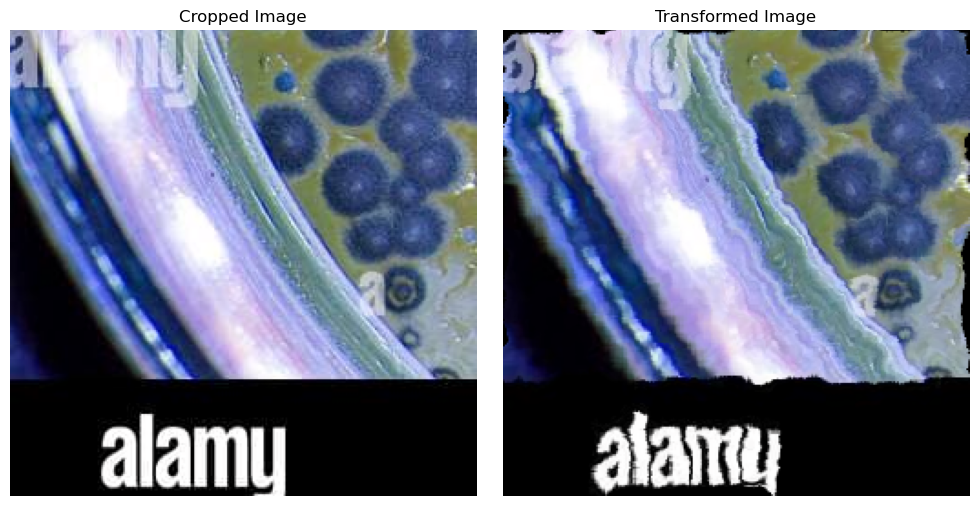

original image shape: (256, 256, 3)
transformed image shape: (256, 256, 3)


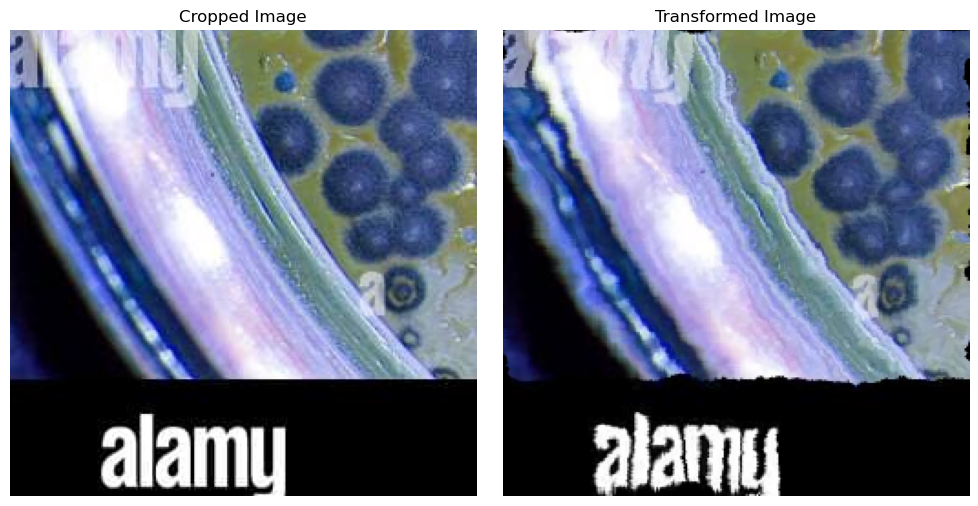

original image shape: (256, 256, 3)
transformed image shape: (256, 256, 3)


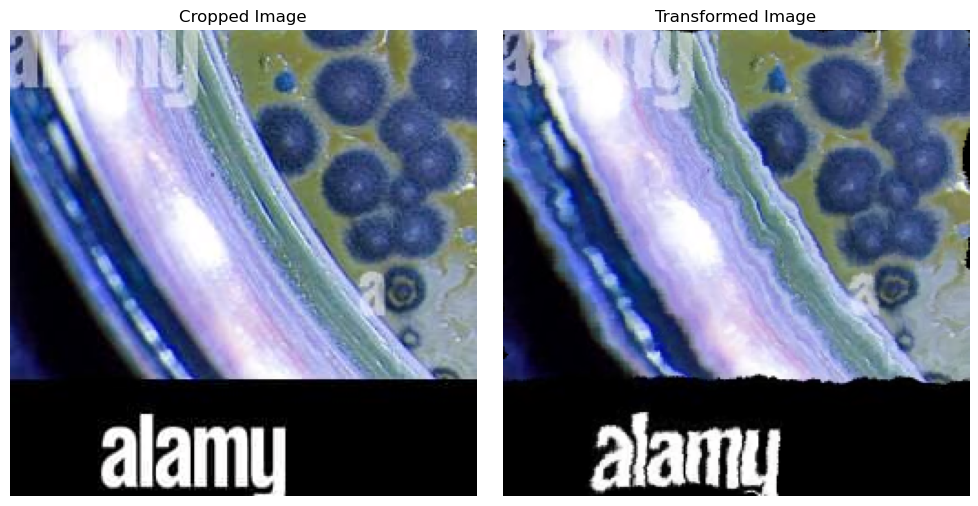

original image shape: (256, 256, 3)
transformed image shape: (256, 256, 3)


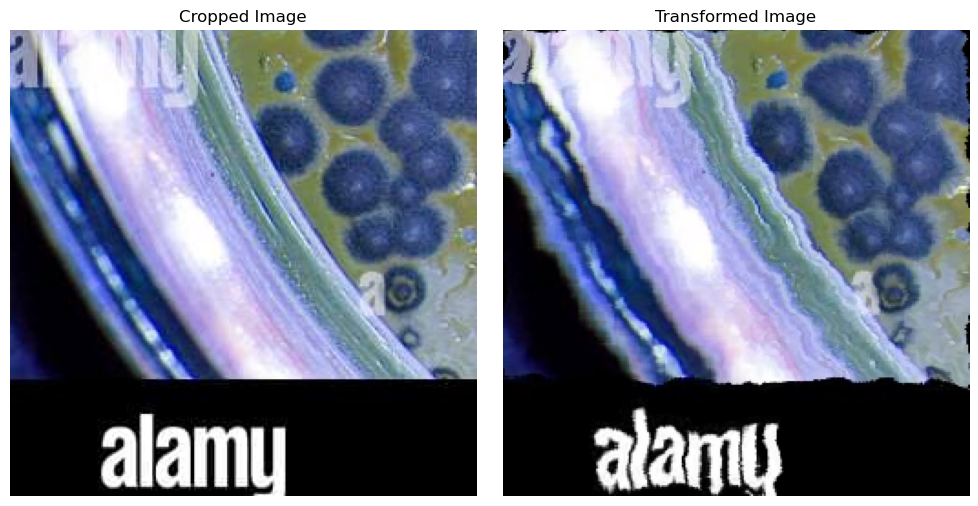

original image shape: (256, 256, 3)
transformed image shape: (256, 256, 3)


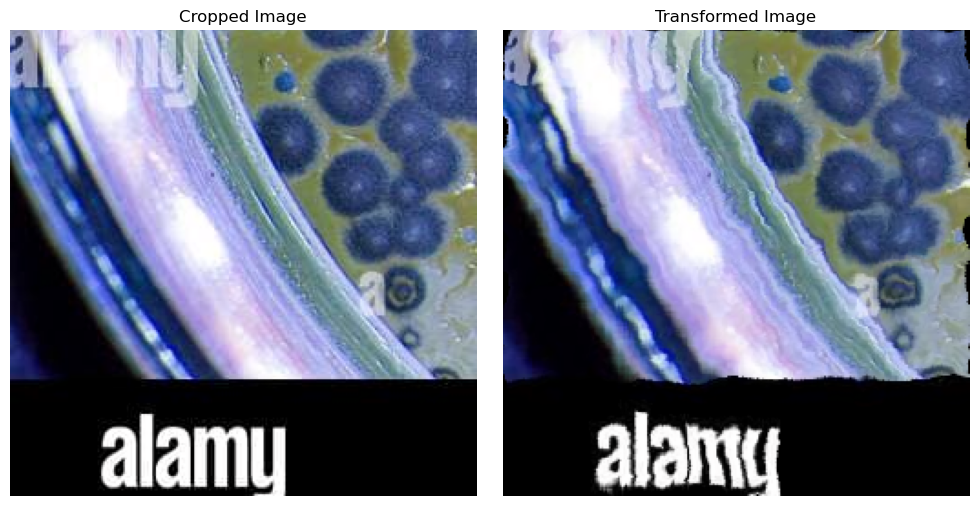

In [36]:
alpha = 100.0
sigma = 10.0

transform = A.ElasticTransform (alpha=alpha, sigma=sigma, p=1.0)

for i in range(5):
    transformed = transform(image=crop)
    print('original image shape:', crop.shape)
    print('transformed image shape:', transformed['image'].shape)
    imshow2(crop, transformed['image'], 'Cropped Image', 'Transformed Image', cmap='gray')